In [1]:
% matplotlib inline
import numpy as np
from scipy import signal, misc, ndimage
from skimage import filters, feature, img_as_float
from skimage.io import imread
from skimage.color import rgb2gray
from PIL import Image, ImageFilter
import matplotlib.pylab as pylab

UsageError: Line magic function `%` not found.


C:\Users\VIGHNESH GAVIT\AppData\Local\Temp\ipykernel_3404\3662738285.py:18: RuntimeWarning: divide by zero encountered in divide
  im_dir = np.arctan(im_y/im_x)
C:\Users\VIGHNESH GAVIT\AppData\Local\Temp\ipykernel_3404\3662738285.py:18: RuntimeWarning: invalid value encountered in divide
  im_dir = np.arctan(im_y/im_x)


<Figure size 640x480 with 0 Axes>

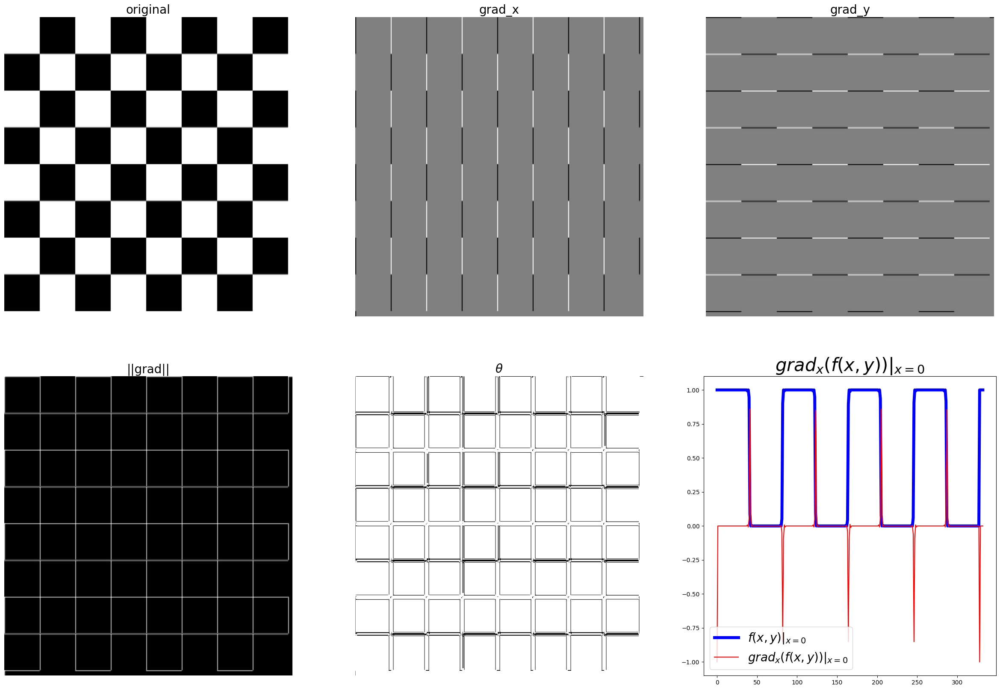

In [3]:
from skimage.color import rgb2gray
from skimage.io import imread
from scipy import signal
import numpy as np
import matplotlib.pylab as pylab

def plot_image(image, title):
    pylab.imshow(image, cmap='gray')
    pylab.title(title, size=20)
    pylab.axis('off')

ker_x = [[-1, 1]]
ker_y = [[-1], [1]]
im = rgb2gray(imread('../images/chess.png')[:,:,:3])  # Extract only the first three channels
im_x = signal.convolve2d(im, ker_x, mode='same')
im_y = signal.convolve2d(im, ker_y, mode='same')
im_mag = np.sqrt(im_x**2 + im_y**2)
im_dir = np.arctan(im_y/im_x)
pylab.gray()
pylab.figure(figsize=(30,20))
pylab.subplot(231), plot_image(im, 'original')
pylab.subplot(232), plot_image(im_x, 'grad_x')
pylab.subplot(233), plot_image(im_y, 'grad_y')
pylab.subplot(234), plot_image(im_mag, '||grad||')
pylab.subplot(235), plot_image(im_dir, r'$\theta$')
pylab.subplot(236)
pylab.plot(range(im.shape[1]), im[0,:], 'b-', label=r'$f(x,y)|_{x=0}$', linewidth=5)
pylab.plot(range(im.shape[1]), im_x[0,:], 'r-', label=r'$grad_x (f(x,y))|_{x=0}$')
pylab.title(r'$grad_x (f(x,y))|_{x=0}$', size=30)
pylab.legend(prop={'size': 20})
pylab.show()


1.0


C:\Users\VIGHNESH GAVIT\AppData\Local\Temp\ipykernel_3404\1149330141.py:17: RuntimeWarning: divide by zero encountered in divide
  im_ang = np.arctan(im_y/im_x)
C:\Users\VIGHNESH GAVIT\AppData\Local\Temp\ipykernel_3404\1149330141.py:17: RuntimeWarning: invalid value encountered in divide
  im_ang = np.arctan(im_y/im_x)


<Figure size 640x480 with 0 Axes>

C:\Users\VIGHNESH GAVIT\AppData\Roaming\Python\Python311\site-packages\matplotlib\cm.py:478: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


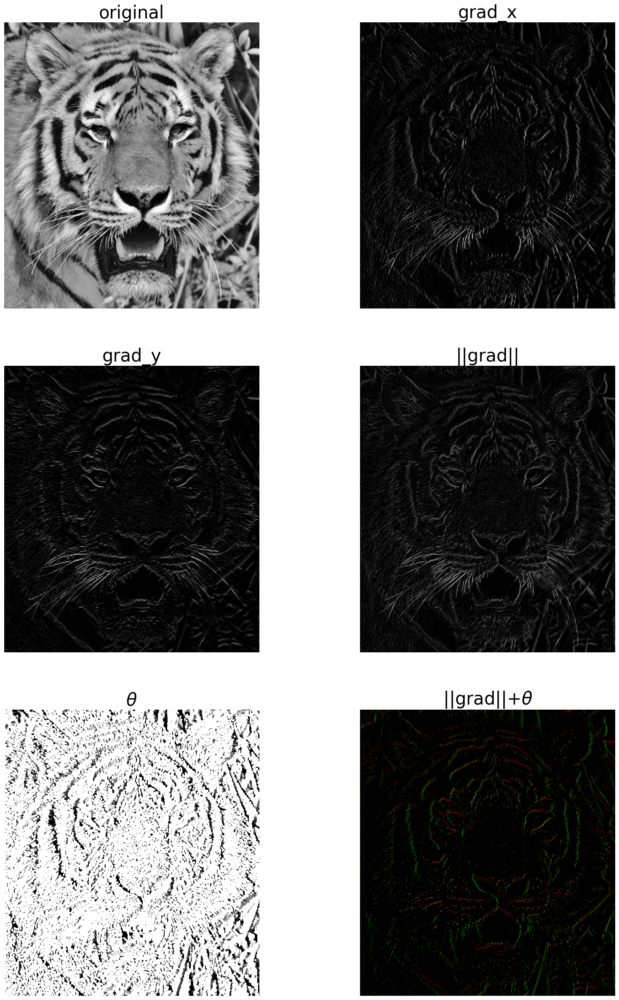

In [5]:
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.util import random_noise
from skimage.filters import gaussian
import matplotlib.pylab as plt
from scipy import signal
import numpy as np
ker_x = [[-1, 1]]
ker_y = [[-1], [1]]
im = rgb2gray(imread('../images/tiger3.jpg'))
#im = random_noise(im, var=sigma**2)
#im = gaussian(im, sigma=0.25)
print(np.max(im))
im_x = np.clip(signal.convolve2d(im, ker_x, mode='same'),0,1)
im_y = np.clip(signal.convolve2d(im, ker_y, mode='same'),0,1)
im_mag = np.sqrt(im_x**2 + im_y**2)
im_ang = np.arctan(im_y/im_x)
plt.gray()
plt.figure(figsize=(20,30))
plt.subplot(321)
plt.imshow(im)
plt.title('original', size=30)
plt.axis('off')
plt.subplot(322)
plt.imshow(im_x)
plt.title('grad_x', size=30)
plt.axis('off')
plt.subplot(323)
plt.imshow(im_y)
plt.title('grad_y', size=30)
plt.axis('off')
plt.subplot(324)
plt.imshow(im_mag)
plt.title('||grad||', size=30)
plt.axis('off')
plt.subplot(325)
plt.imshow(im_ang)
plt.title(r'$\theta$', size=30)
plt.axis('off')
plt.subplot(326)
im = np.zeros((im.shape[0],im.shape[1],3))
im[...,0] = im_mag*np.sin(im_ang)
im[...,1] = im_mag*np.cos(im_ang)
plt.imshow(im)
plt.title(r'||grad||+$\theta$', size=30)
plt.axis('off')
plt.show()

<Figure size 640x480 with 0 Axes>

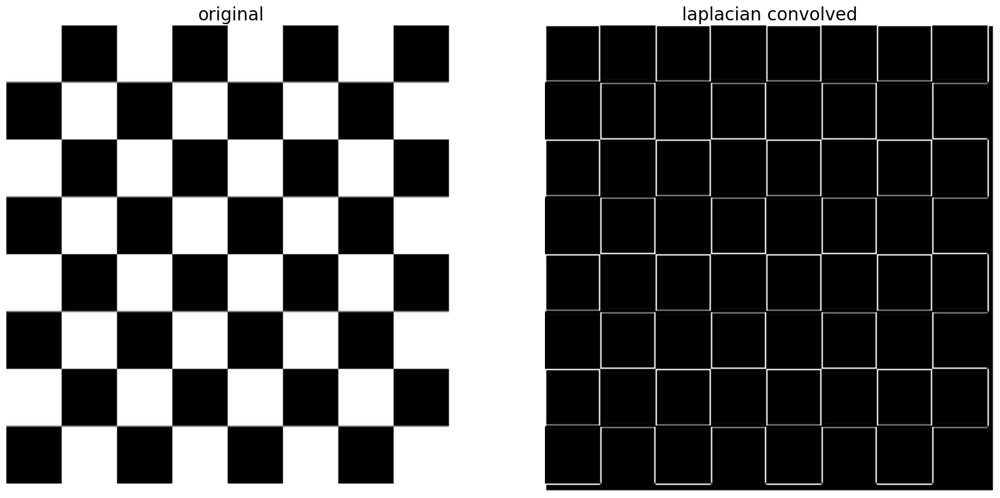

In [6]:
from skimage.color import rgba2rgb

ker_laplacian = [[0,-1,0],[-1, 4, -1],[0,-1,0]]
im = rgb2gray(rgba2rgb(imread('../images/chess.png')))
im1 = np.clip(signal.convolve2d(im, ker_laplacian, mode='same'),0,1)
pylab.gray()
pylab.figure(figsize=(20,10))
pylab.subplot(121), plot_image(im, 'original')
pylab.subplot(122), plot_image(im1, 'laplacian convolved')
pylab.show()

C:\Users\VIGHNESH GAVIT\AppData\Local\Temp\ipykernel_3404\2840020444.py:22: RuntimeWarning: divide by zero encountered in divide
  im_ang = np.arctan(im_y/im_x)
C:\Users\VIGHNESH GAVIT\AppData\Local\Temp\ipykernel_3404\2840020444.py:22: RuntimeWarning: invalid value encountered in divide
  im_ang = np.arctan(im_y/im_x)


<Figure size 640x480 with 0 Axes>

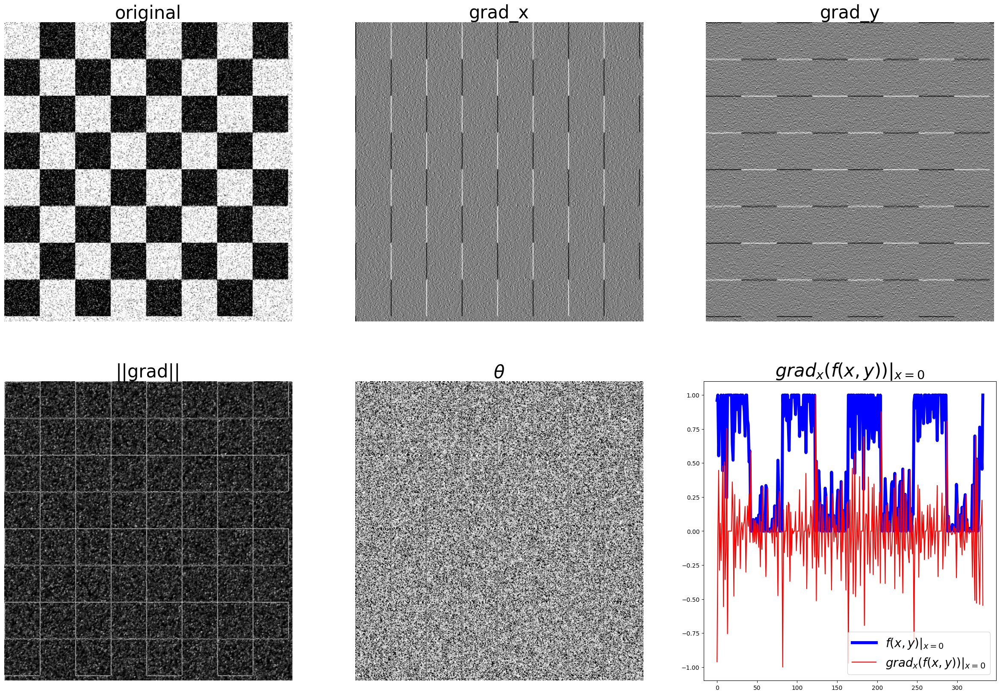

In [7]:
from skimage.color import rgb2gray
from skimage.io import imread
from skimage.util import random_noise
from skimage.filters import gaussian
import matplotlib.pylab as plt
from scipy import signal
import numpy as np

ker_x = [[-1, 1]]
ker_y = [[-1], [1]]
im = rgb2gray(imread('../images/chess.png')[:, :, :3])  # Extract only the first three channels (R, G, B)
sigma = 0.25
sign = np.random.random(im.shape)
sign[sign <= 0.5] = -1
sign[sign > 0.5] = 1
im = random_noise(im, var=sigma**2)
im = gaussian(im, sigma=0.25)

im_x = signal.convolve2d(im, ker_x, mode='same')
im_y = signal.convolve2d(im, ker_y, mode='same')
im_mag = np.sqrt(im_x**2 + im_y**2)
im_ang = np.arctan(im_y/im_x)

plt.gray()
plt.figure(figsize=(30, 20))
plt.subplot(231)
plt.imshow(im)
plt.title('original', size=30)
plt.axis('off')
plt.subplot(232)
plt.imshow(im_x)
plt.title('grad_x', size=30)
plt.axis('off')
plt.subplot(233)
plt.imshow(im_y)
plt.title('grad_y', size=30)
plt.axis('off')
plt.subplot(234)
plt.imshow(im_mag)
plt.title('||grad||', size=30)
plt.axis('off')
plt.subplot(235)
plt.imshow(im_ang)
plt.title(r'$\theta$', size=30)
plt.axis('off')
plt.subplot(236)
plt.plot(range(im.shape[1]), im[0, :], 'b-', label=r'$f(x,y)|_{x=0}$', linewidth=5)
plt.plot(range(im.shape[1]), im_x[0, :], 'r-', label=r'$grad_x (f(x,y))|_{x=0}$')
plt.title(r'$grad_x (f(x,y))|_{x=0}$', size=30)
plt.legend(prop={'size': 20})
plt.show()


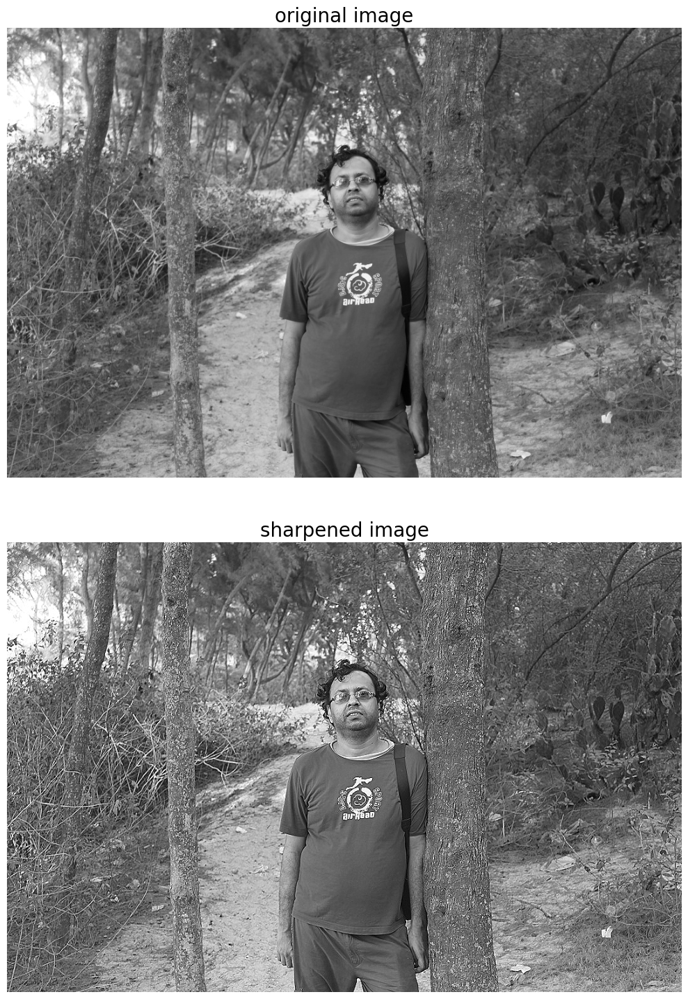

In [9]:
from skimage.filters import laplace
im = rgb2gray(imread('../images/me8.jpg'))
im1 = np.clip(laplace(im) + im, 0, 1)
pylab.figure(figsize=(10,15))
pylab.subplot(211), plot_image(im, 'original image')
pylab.subplot(212), plot_image(im1, 'sharpened image')
pylab.tight_layout()
pylab.show()

<Figure size 640x480 with 0 Axes>

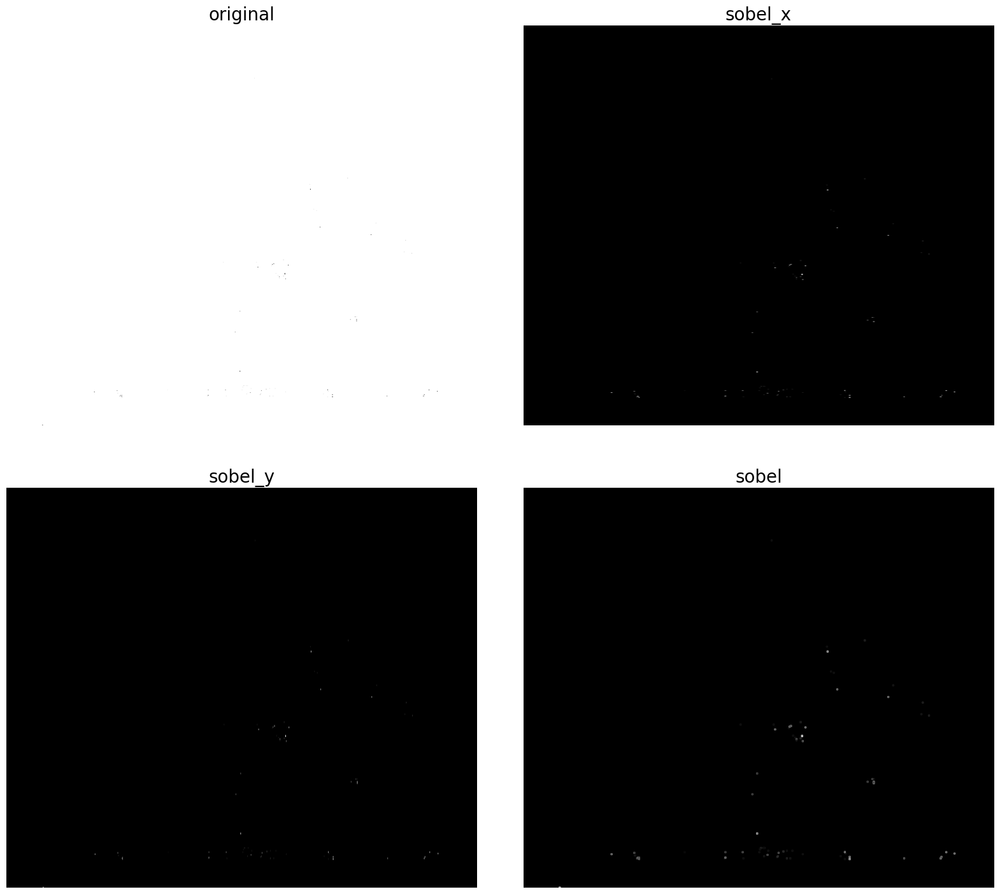

In [ ]:
im = rgb2gray(imread('../images/tajmahal1.jpg')) # RGB image to gray scale
pylab.gray()
pylab.figure(figsize=(20,18))
pylab.subplot(2,2,1)
plot_image(im, 'original')
pylab.subplot(2,2,2)
edges_x = filters.sobel_h(im)
plot_image(np.clip(edges_x,0,1), 'sobel_x')
pylab.subplot(2,2,3)
edges_y = filters.sobel_v(im)
plot_image(np.clip(edges_y,0,1), 'sobel_y')
pylab.subplot(2,2,4)
edges = filters.sobel(im)
plot_image(np.clip(edges,0,1), 'sobel')
pylab.subplots_adjust(wspace=0.1, hspace=0.1)
pylab.show()

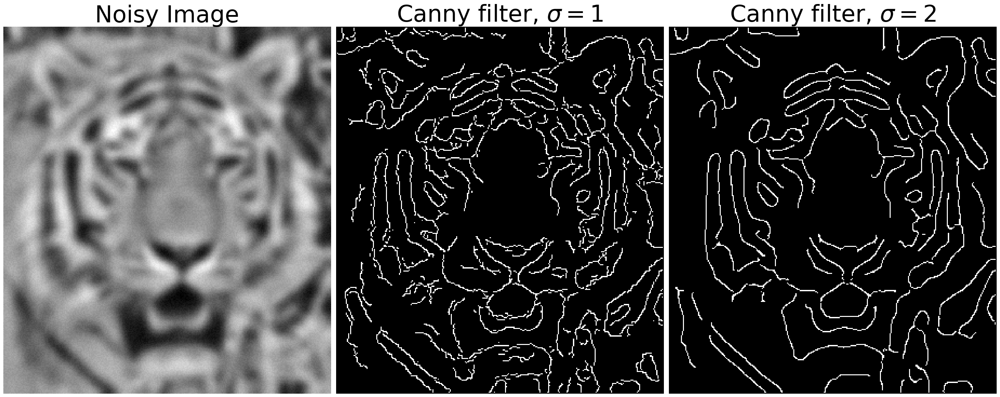

In [15]:
from skimage.color import rgb2gray
from skimage.io import imread
from skimage import feature
import scipy.ndimage as ndimage
import numpy as np
import matplotlib.pyplot as plt

# Load the RGB image and convert it to grayscale
im = rgb2gray(imread('../images/tiger3.jpg'))
im = ndimage.gaussian_filter(im, 4)
im += 0.05 * np.random.random(im.shape)

edges1 = feature.canny(im)
edges2 = feature.canny(im, sigma=2)

# Plotting
fig, (axes1, axes2, axes3) = plt.subplots(nrows=1, ncols=3, figsize=(30, 12), sharex=True, sharey=True)

axes1.imshow(im, cmap=plt.cm.gray)
axes1.axis('off')
axes1.set_title('Noisy Image', fontsize=50)

axes2.imshow(edges1, cmap=plt.cm.gray)
axes2.axis('off')
axes2.set_title('Canny filter, $\sigma=1$', fontsize=50)

axes3.imshow(edges2, cmap=plt.cm.gray)
axes3.axis('off')
axes3.set_title('Canny filter, $\sigma=2$', fontsize=50)

fig.tight_layout()
plt.show()

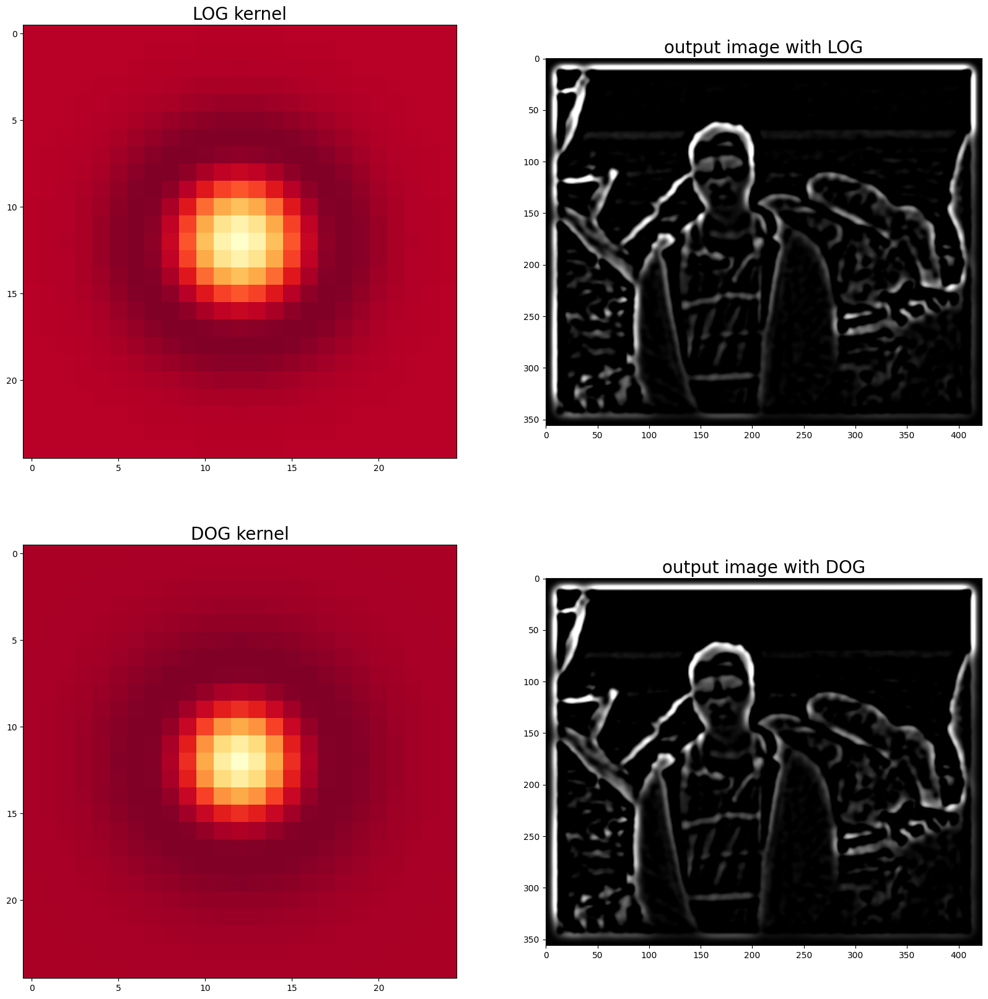

In [17]:
from scipy.signal import convolve2d
from skimage.io import imread
from scipy.ndimage import gaussian_filter
from numpy import pi
import numpy as np
import matplotlib.pylab as pylab

def plot_kernel(kernel, s, name):
    pylab.imshow(kernel, cmap='YlOrRd')

def LOG(k=12, s=3):
    n = 2 * k + 1  # size of the kernel
    kernel = np.zeros((n, n))
    for i in range(n):
        for j in range(n):
            kernel[i, j] = -(1 - ((i - k) ** 2 + (j - k) ** 2) / (2. * s ** 2)) * np.exp(
                -((i - k) ** 2 + (j - k) ** 2) / (2. * s ** 2)) / (pi * s ** 4)
    kernel = np.round(kernel / np.sqrt((kernel ** 2).sum()), 3)
    return kernel

def DOG(k=12, s=3):
    n = 2 * k + 1  # size of the kernel
    s1, s2 = s * np.sqrt(2), s / np.sqrt(2)
    kernel = np.zeros((n, n))
    for i in range(n):
        for j in range(n):
            kernel[i, j] = np.exp(-((i - k) ** 2 + (j - k) ** 2) / (2. * s1 ** 2)) / (2 * pi * s1 ** 2) - np.exp(
                -((i - k) ** 2 + (j - k) ** 2) / (2. * s2 ** 2)) / (2 * pi * s2 ** 2)
    kernel = np.round(kernel / np.sqrt((kernel ** 2).sum()), 3)
    return kernel

s = 3  # sigma value for LoG
img = rgb2gray(imread('../images/me.jpg'))
kernel = LOG()
outimg = convolve2d(img, kernel)
pylab.figure(figsize=(20, 20))
pylab.subplot(221), pylab.title('LOG kernel', size=20), plot_kernel(kernel, s, 'DOG')
pylab.subplot(222), pylab.title('output image with LOG', size=20)
pylab.imshow(np.clip(outimg, 0, 1), cmap='gray')  # clip the pixel values in between 0 and 1
kernel = DOG()
outimg = convolve2d(img, DOG())
pylab.subplot(223), pylab.title('DOG kernel', size=20), plot_kernel(kernel, s, 'DOG')
pylab.subplot(224), pylab.title('output image with DOG', size=20)
pylab.imshow(np.clip(outimg, 0, 1), cmap='gray')
pylab.show()


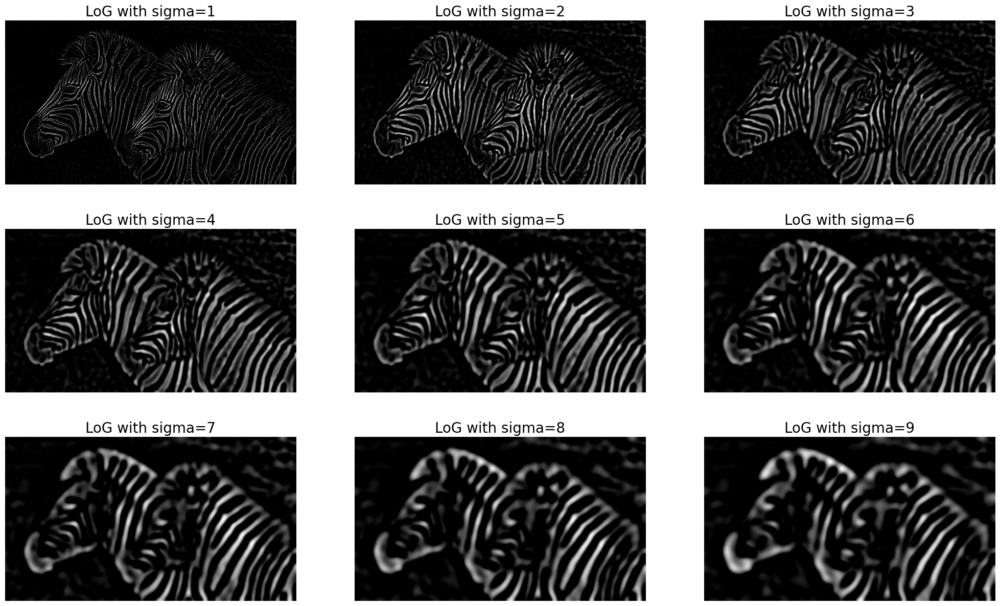

In [18]:
img = rgb2gray(imread('../images/zebras.jpg'))
fig = pylab.figure(figsize=(25,15))
pylab.gray() # show the filtered result in grayscale
for sigma in range(1,10):
    pylab.subplot(3,3,sigma)
    img_log = ndimage.gaussian_laplace(img, sigma=sigma)
    pylab.imshow(np.clip(img_log,0,1)), pylab.axis('off')
    pylab.title('LoG with sigma=' + str(sigma), size=20)
pylab.show()

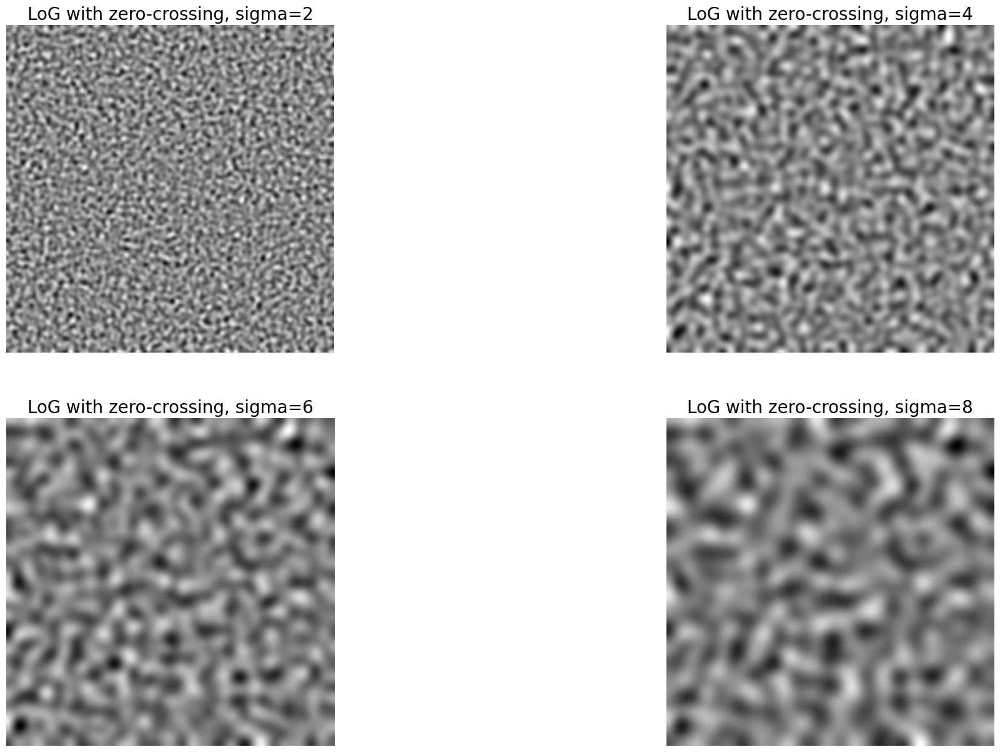

In [19]:
import numpy as np
import scipy.ndimage as ndimage
import matplotlib.pyplot as plt

def zero_crossing(image):
    # Implement the zero-crossing function here
    return image

# Create a synthetic image (you can replace this with your own image)
img = np.random.rand(256, 256)

fig = plt.figure(figsize=(25, 15))
plt.gray()

for sigma in range(2, 10, 2):
    plt.subplot(2, 2, int(sigma/2))  # Convert sigma/2 to an integer
    result = ndimage.gaussian_laplace(img, sigma=sigma)
    zero_crossing_result = zero_crossing(result)
    plt.imshow(zero_crossing_result, cmap='gray')
    plt.axis('off')
    plt.title('LoG with zero-crossing, sigma=' + str(sigma), size=20)

plt.show()


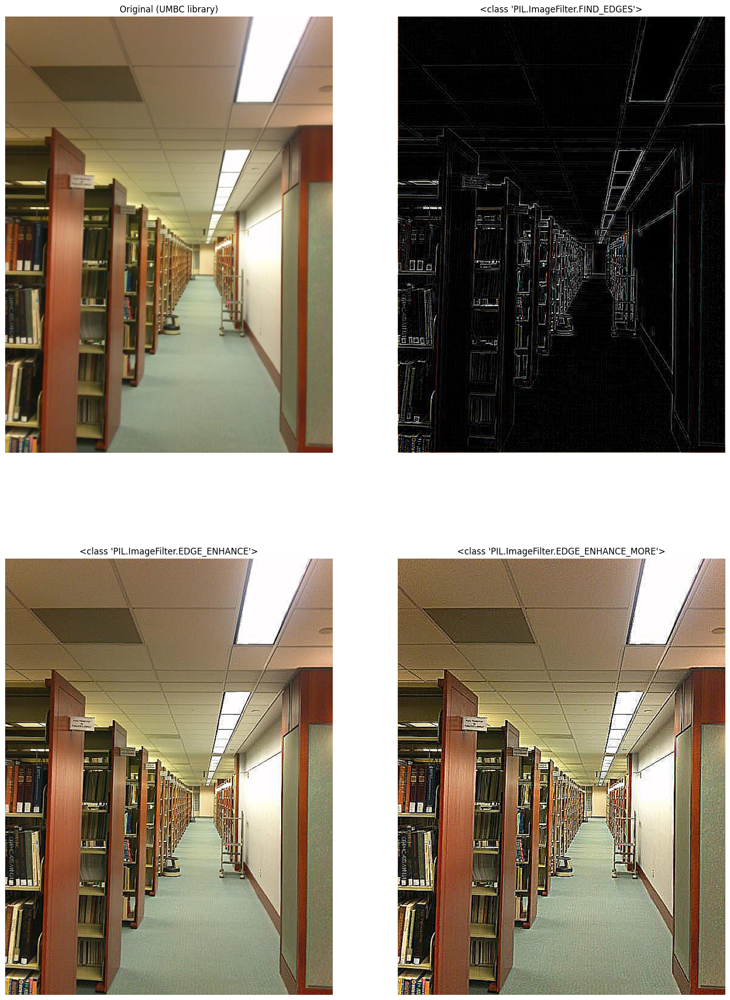

In [21]:
from PIL import Image, ImageFilter
import matplotlib.pyplot as plt

# Assuming you have a function plot_image, you need to define it
def plot_image(im, title):
    plt.imshow(im)
    plt.title(title)
    plt.axis('off')

im = Image.open('../images/umbc_lib.jpg')
plt.figure(figsize=(18, 25))
plt.subplot(2, 2, 1)
plot_image(im, 'Original (UMBC library)')

i = 2
for f in (ImageFilter.FIND_EDGES, ImageFilter.EDGE_ENHANCE, ImageFilter.EDGE_ENHANCE_MORE):
    plt.subplot(2, 2, i)
    im1 = im.filter(f)
    plot_image(im1, str(f))
    i += 1

plt.show()

TypeError: Invalid shape (110, 110, 2) for image data

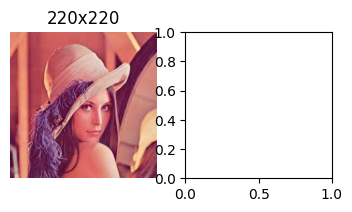

In [22]:
from skimage.transform import pyramid_gaussian
image = imread('../images/lena.jpg')
nrows, ncols = image.shape[:2]
pyramid = tuple(pyramid_gaussian(image, downscale=2)) #, multichannel=True))

plt.figure(figsize=(20,5))
i, n = 1, len(pyramid)
for p in pyramid:
    plt.subplot(1,n,i), plt.imshow(p),  plt.title(str(p.shape[0]) + 'x' + str(p.shape[1])), plt.axis('off')
    i += 1
plt.suptitle('Gaussian Pyramid', size=30)
plt.show()

compos_image = np.zeros((nrows, ncols + ncols // 2, 3), dtype=np.double)
compos_image[:nrows, :ncols, :] = pyramid[0]

i_row = 0
for p in pyramid[1:]:
    n_rows, n_cols = p.shape[:2]
    compos_image[i_row:i_row + n_rows, ncols:ncols + n_cols] = p
    i_row += n_rows

fig, ax = plt.subplots(figsize=(20,20))
ax.imshow(composite_image)
plt.show()

ValueError: the input array must have size 3 along `channel_axis`, got (110, 110, 2)

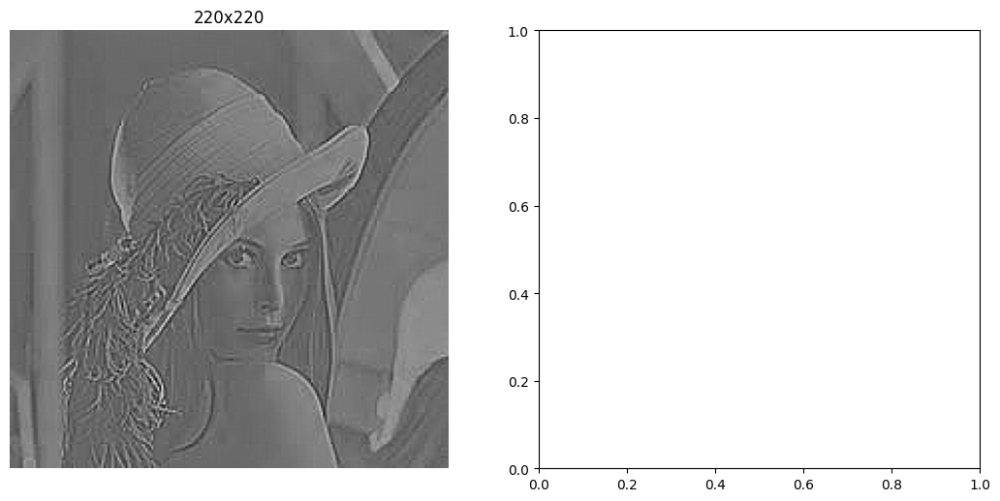

In [23]:
import numpy as np
import matplotlib.pyplot as plt

from skimage.transform import pyramid_laplacian
from skimage.color import rgb2gray

image = imread('../images/lena.jpg')

nrows, ncols = image.shape[:2]
pyramid = tuple(pyramid_laplacian(image, downscale=2)) #, multichannel=True))

plt.figure(figsize=(20,20))
i, n = 1, len(pyramid)
for p in pyramid:
    plt.subplot(3,3,i), plt.imshow(rgb2gray(p), cmap='gray'), plt.title(str(p.shape[0]) + 'x' + str(p.shape[1]))
    plt.axis('off')
    i += 1
plt.suptitle('Laplacian Pyramid', size=30)
plt.show()

composite_image = np.zeros((nrows, ncols + ncols // 2), dtype=np.double)

composite_image[:nrows, :ncols] = rgb2gray(pyramid[0])

i_row = 0
for p in pyramid[1:]:
    n_rows, n_cols = p.shape[:2]
    composite_image[i_row:i_row + n_rows, ncols:ncols + n_cols] = rgb2gray(p)
    i_row += n_rows

fig, ax = plt.subplots(figsize=(20,20))
ax.imshow(composite_image, cmap='gray')
plt.show()

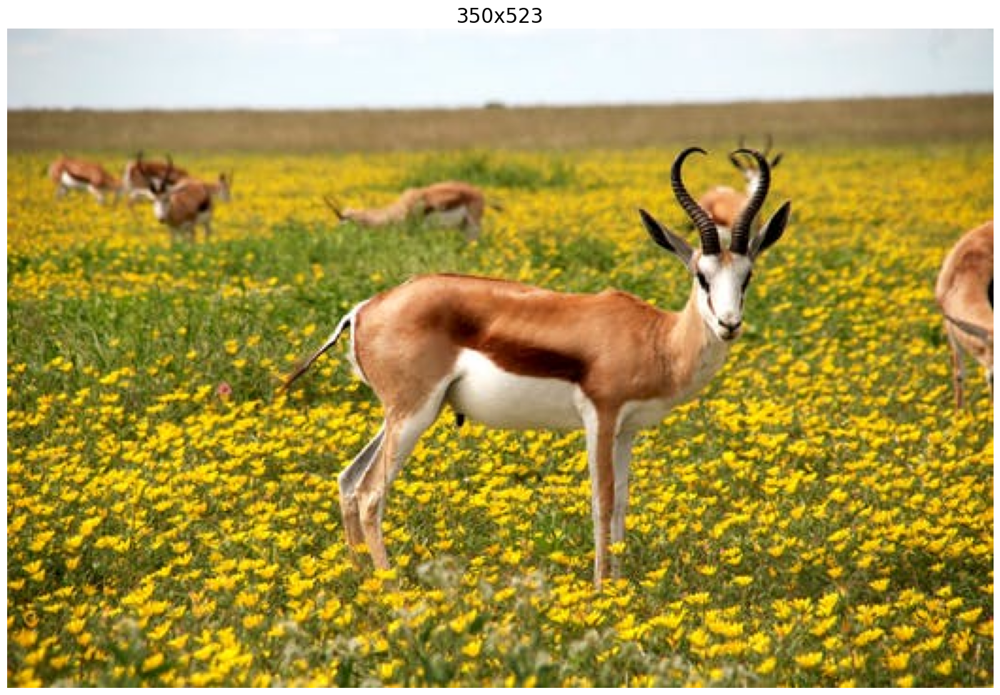

TypeError: Invalid shape (175, 262, 2) for image data

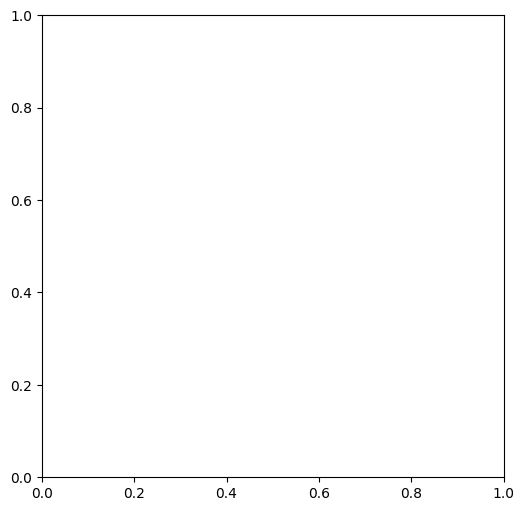

In [26]:
import numpy as np
import matplotlib.pyplot as plt

from skimage.io import imread
from skimage.color import rgb2gray
from skimage.transform import pyramid_reduce, pyramid_laplacian, pyramid_expand, resize

image = imread('../images/antelops.jpeg')

def get_gaussian_pyramid(image):
    rows, cols, dim = image.shape
    gaussian_pyramid = [image]
    while rows > 1 and cols > 1:
        #print(rows, cols)
        image = pyramid_reduce(image, downscale=2)
        gaussian_pyramid.append(image)
        #print(image.shape)
        rows //= 2
        cols //= 2
    return gaussian_pyramid

def get_laplacian_pyramid(gaussian_pyramid):
    laplacian_pyramid = [gaussian_pyramid[len(gaussian_pyramid)-1]]
    for i in range(len(gaussian_pyramid)-2, -1, -1):
        image = gaussian_pyramid[i] - resize(pyramid_expand(gaussian_pyramid[i+1]), gaussian_pyramid[i].shape)
        #print(i, image.shape)
        laplacian_pyramid.append(np.copy(image))
    laplacian_pyramid = laplacian_pyramid[::-1]
    return laplacian_pyramid


gaussian_pyramid = get_gaussian_pyramid(image)
laplacian_pyramid = get_laplacian_pyramid(gaussian_pyramid)
    
w, h = 20, 12
for i in range(3):
    plt.figure(figsize=(w,h))
    p = gaussian_pyramid[i]
    plt.imshow(p)
    plt.title(str(p.shape[0]) + 'x' + str(p.shape[1]), size=20)
    plt.axis('off')
    w, h = w / 2, h / 2
    plt.show()
    
w, h = 10, 6
for i in range(1,4):
    plt.figure(figsize=(w,h))
    p = laplacian_pyramid[i]
    plt.imshow(rgb2gray(p), cmap='gray')
    plt.title(str(p.shape[0]) + 'x' + str(p.shape[1]), size=20)
    plt.axis('off')
    w, h = w / 2, h / 2
    plt.show()

TypeError: Invalid shape (154, 222, 2) for image data

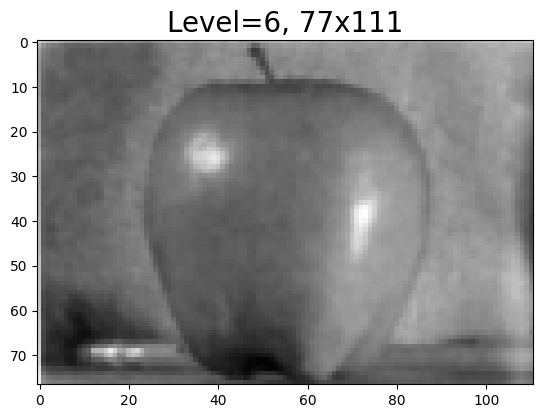

In [28]:
def reconstruct_image_from_laplacian_pyramid(pyramid):
    i = len(pyramid) - 2
    prev = pyramid[i+1]
    #plt.figure(figsize=(20,20))
    j = 1
    while i >= 0:
        prev = resize(pyramid_expand(prev, upscale=2), pyramid[i].shape)
        im = np.clip(pyramid[i] + prev,0,1)
        #plt.subplot(3,3,j)
        plt.imshow(im)
        plt.title('Level=' + str(j) + ', ' + str(im.shape[0]) + 'x' + str(im.shape[1]), size=20)
        prev = im
        i -= 1
        j += 1
    return im

image = imread('../images/apple.png')[...,:3] / 255
pyramid = get_laplacian_pyramid(get_gaussian_pyramid(image))
im = reconstruct_image_from_laplacian_pyramid(pyramid)

In [29]:
% matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

A = imread('../images/apple.png')[...,:3] / 255
B = imread('../images/orange.png')[...,:3] / 255
M = imread('../images/mask.png')[...,:3] / 255

rows, cols, dim = A.shape
pyramidA = get_laplacian_pyramid(get_gaussian_pyramid(A))
pyramidB = get_laplacian_pyramid(get_gaussian_pyramid(B))
pyramidM = get_gaussian_pyramid(M)

pyramidC = []
for i in range(len(pyramidM)):
    im = pyramidM[i]*pyramidA[i] + (1-pyramidM[i])*pyramidB[i]
    #print(np.max(im), np.min(im), np.mean(im))
    pyramidC.append(im)

im = reconstruct_image_from_laplacian_pyramid(pyramidC)

plt.imshow(im)
plt.axis('off')
plt.show()

UsageError: Line magic function `%` not found.
